In [44]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage import io, color, img_as_bool, exposure, transform, feature
import matplotlib.image as mpimg
%matplotlib inline

## read and describe the metadata

In [45]:
ls

ML bertin visual variables definitions.pdf*
README.md*
cluster_images.csv*
cluster_starter-Copy1.ipynb
cluster_starter.ipynb*
contents-of-cluster_images.csv*
img_small/


In [46]:
fpn_csv = './cluster_images.csv'
data = pd.read_csv(fpn_csv, encoding='ISO-8859-1')

In [47]:
# get column names
list(data)

['s_no',
 'artist',
 'title',
 'art_movement',
 'museum_venue',
 'country_of_origin',
 'has_text',
 'primary_medium',
 'medium',
 'work_size',
 'date',
 'representation',
 'representation_semi',
 'kinetic',
 'map',
 'map2',
 'spatial_dimension',
 'spatial_dimension2',
 'pl',
 'si',
 'va',
 'te',
 'co',
 'or',
 'sh',
 'reflection',
 'po',
 'li',
 'ar',
 'notes']

In [51]:
data.head()

,s_no,artist,title,art_movement,museum_venue,country_of_origin,has_text,primary_medium,medium,work_size,...,va,te,co,or,sh,reflection,po,li,ar,notes
0,2,Giorgio de Chirico,The Uncertainty of the Poet,surrealism,Tate,Italy,False,painting,"painting, oil on canvas",106 x 94 cm,...,3,0,0,4,3,False,0,0,5,"distorted perspective, shadow, signification o..."
1,3,Giovanni Anselmo,Direction,arte povera,Tate,Italy,False,sculpture,"sculpture, fabric, glass & metal",24 x 420 x 335 cm,...,1,3,0,3,2,False,0,0,5,"hard to understand the viewpoint, sense of for..."
2,4,Milton Avery,Yellow Sky,modernism,Tate,America,False,painting,"painting, oil on canvas",156 x 184 cm,...,2,4,4,2,4,False,0,0,5,"flatish, textured shapes & specific colors-lin..."
3,5,Gillian Avery,Distillation,abstraction,Tate,UK,False,painting,"painting, oil, household paint on hardboard",213 x 152 cm,...,1,2,0,2,4,False,0,0,5,"shapes, layers, paint handlng/texture, orienta..."
4,6,Joseph (Jef) Banc,Pair-Bearing Matrix,abstraction,Tate,France,False,painting,"painting, mixed media on canvas",73 x 60 cm,...,1,4,1,0,4,False,0,0,5,"ambiguity through abstraction, odd shape, v te..."


## create a subset of the columns you will use to fit KMeans

Here, I am **arbitrarily** choosing the seven [visual variables defined by Bertin](https://infovis-wiki.net/wiki/Visual_Variables). Variable descriptions [here](https://github.com/visualizedata/ml/blob/master/ML_assignment_3/option_2/contents-of-cluster_images.csv). 

You should choose the columns that you decide will best define the clusters. You may need to make transformations on existing variables. 

In [61]:
X = data[['pl', 'si', 'va', 'te', 'co', 'or', 'sh']]

### ha: Degrees of white and black
### co: hue
### or: dinstince orientations

In [127]:
X = data[['va', 'co', 'or']]

In [185]:
X.head()

,va,co,or
0,3,0,4
1,1,0,3
2,2,4,2
3,1,0,2
4,1,1,0


# KMeans

In [109]:
from sklearn.cluster import KMeans

## plot inertia scores by number of clusters

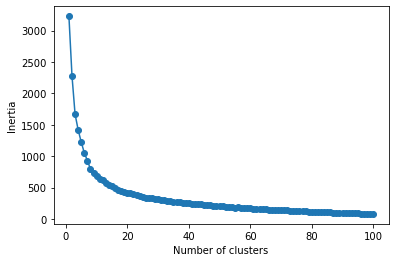

In [118]:
# first attempt at fitting K means to view change in Inertia

# container to store inertia scores over iterations
distortions = []

# fit KMeans iteratively to begin to assess the appropriate number of clusters
for i in range(1, 101):
    km = KMeans(n_clusters=i)
    km.fit(X)
    distortions.append(km.inertia_)
    
# vizualize change in inertia
plt.plot(range(1, 101), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

## create silhouette plots to assess various specifications for `n_clusters` in `KMeans`

In [128]:
# modify this list to include the numbers of clusters you want to see
# I have *arbitrarily* chosen these values
range_n_clusters = [2,3,4,5,6,7,8]

For n_clusters = 2 The average silhouette_score is : 0.3677136274858439


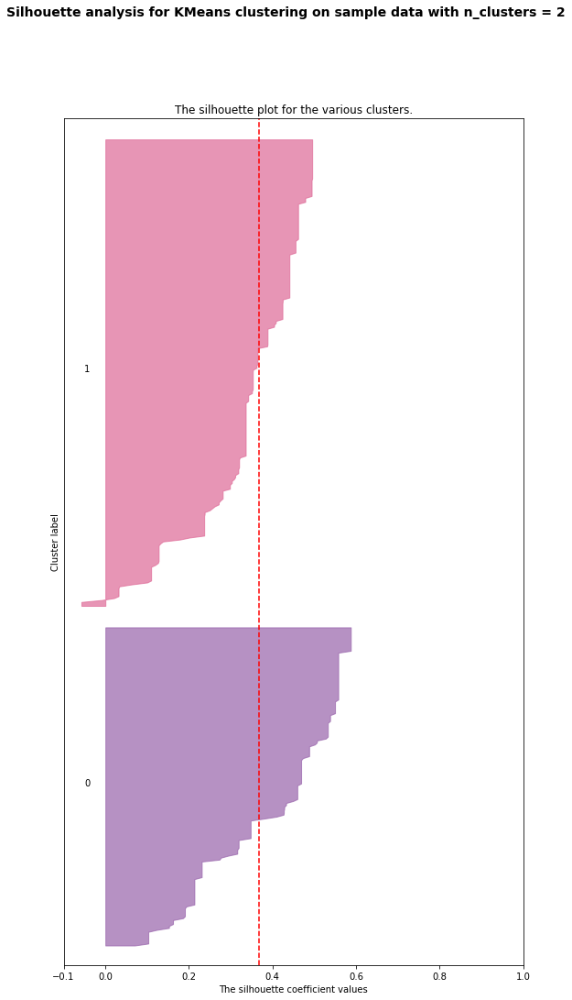

For n_clusters = 3 The average silhouette_score is : 0.42091729223577456


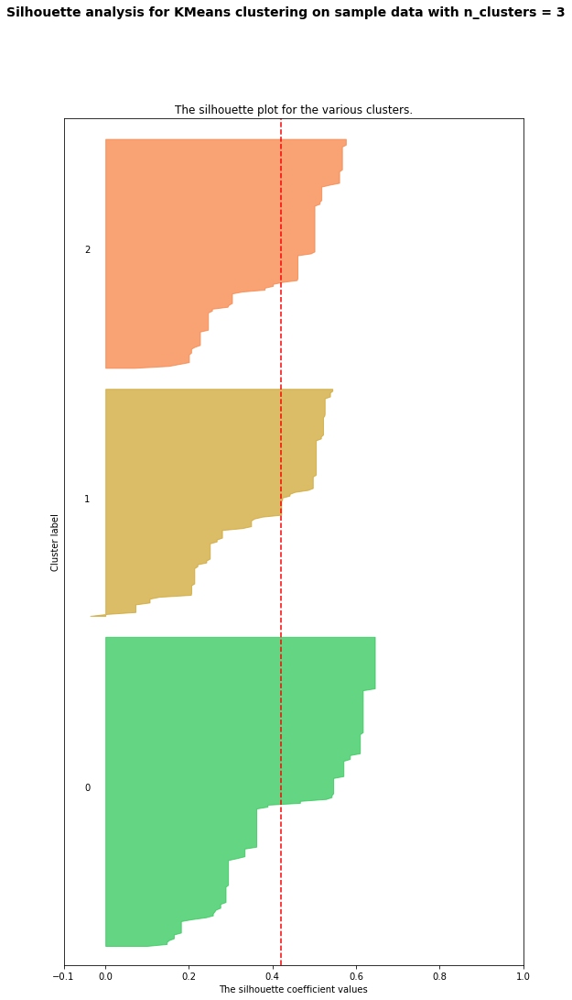

For n_clusters = 4 The average silhouette_score is : 0.43604418818870605


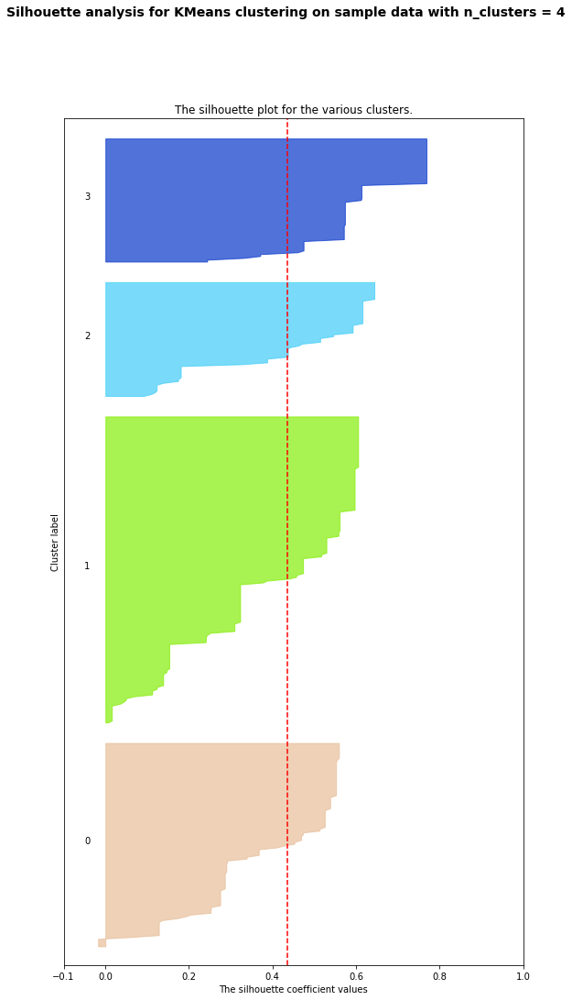

For n_clusters = 5 The average silhouette_score is : 0.4448961395741831


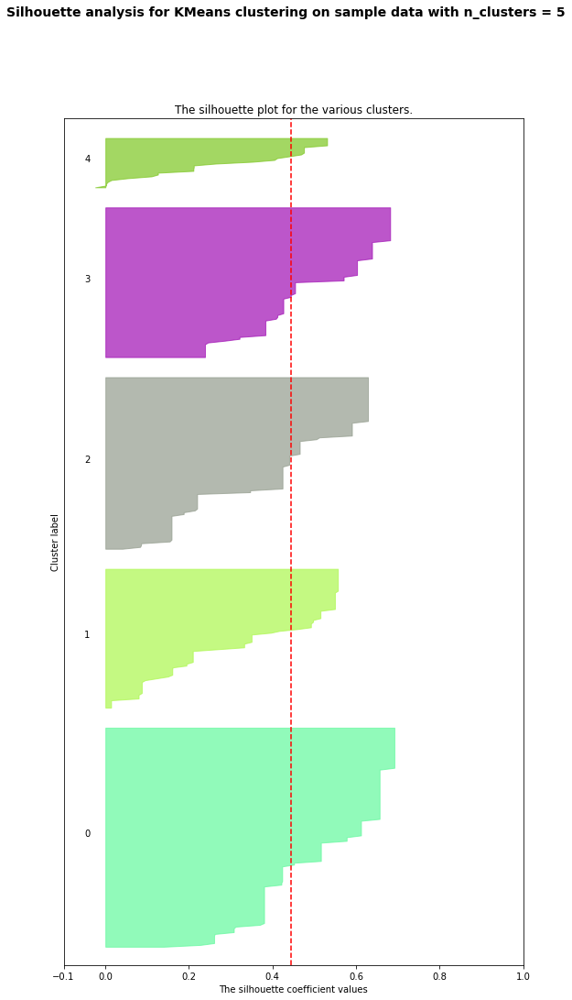

For n_clusters = 6 The average silhouette_score is : 0.43255744114909883


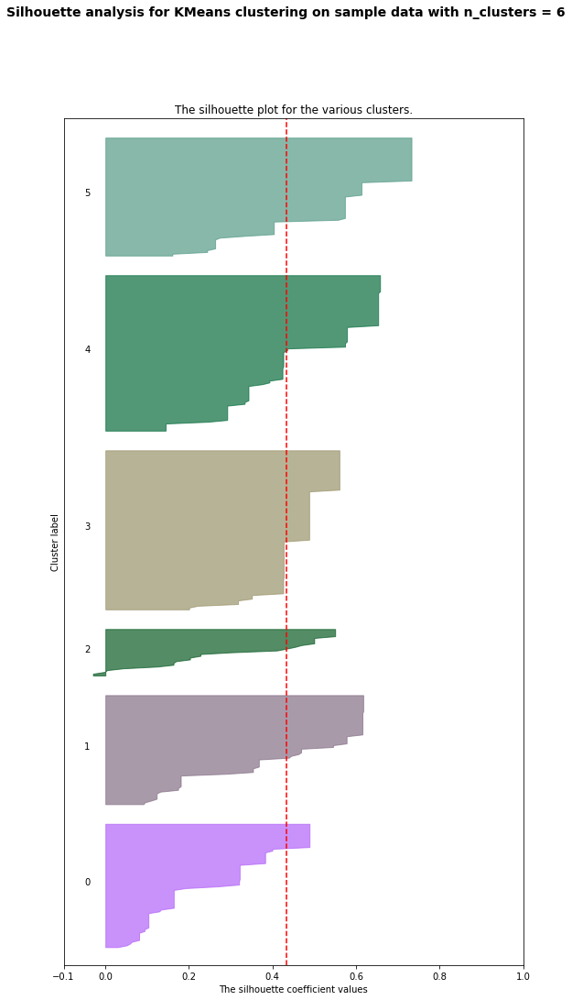

For n_clusters = 7 The average silhouette_score is : 0.4251409950720923


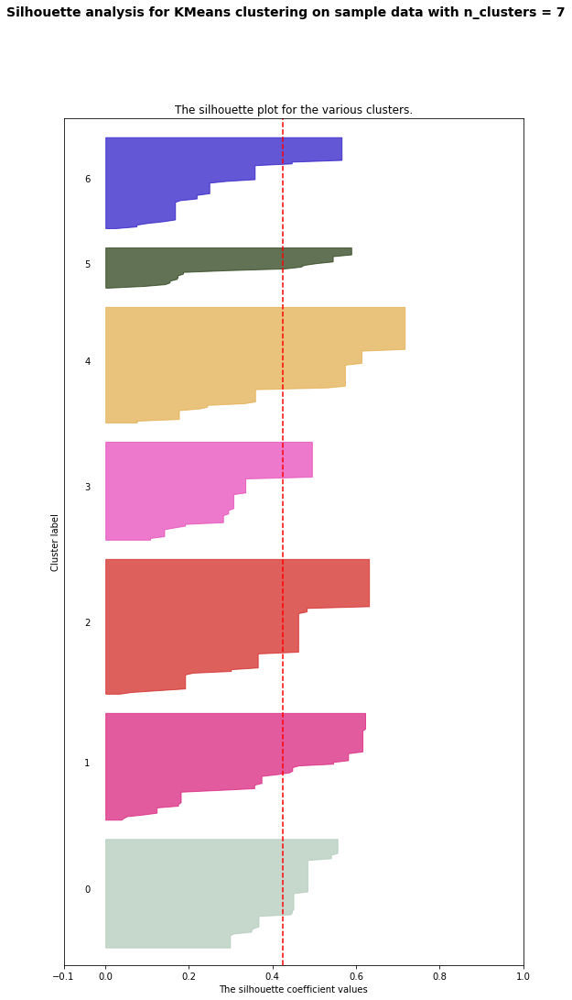

For n_clusters = 8 The average silhouette_score is : 0.4166983949543613


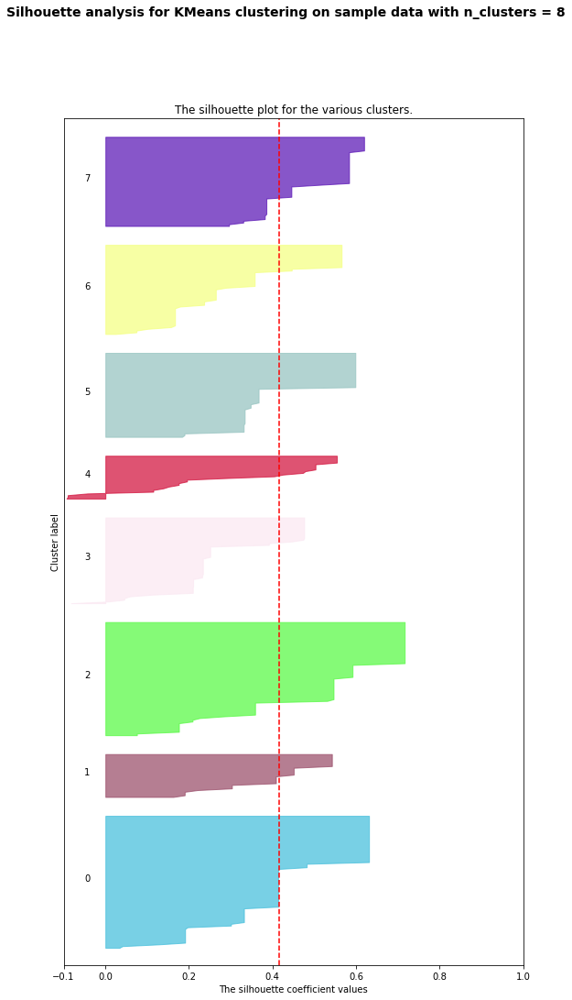

In [129]:
# modified from: http://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html

from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
import random

for n_clusters in range_n_clusters:
    # Create a subplot
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(9, 17)

    # The silhouette coefficient can range from -1, 1 but in this example all lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters, "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        # select a random color for this cluster
        r = lambda: random.randint(0,255)
        color = '#%02X%02X%02X' % (r(),r(),r())
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

    plt.show()

## final fit

Chosed 5 for the higest average silhouette coefficient value

In [186]:
# set the number of clusters in the final model
my_n_clusters = 5

In [187]:
km = KMeans(n_clusters=my_n_clusters)
km.fit(X)

KMeans(n_clusters=5)

### A fnuction to show image results

In [188]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def process(filename: str=None) -> None:
    """
    View multiple images stored in files, stacking vertically

    Arguments:
        filename: str - path to filename containing image
    """
    image = mpimg.imread(filename)
    # <something gets done here>
    plt.figure()
    plt.title(filename)
    plt.imshow(image)


## look at results

The key to knowing if you have chosen the right features and clusters: looking at the images in each cluster and deciding whether they seem to belong together. You could extend this starter code to display the images in this notebook, or you may decide to use Python to write an html file/files to view the images by cluster.

In [189]:
for i in range(0, max(km.labels_)+1):
    print(" ")
    print("* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
    print("Images in cluster: " + str(i))
    print("* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
    for j in range(0, len(km.labels_)):
        if km.labels_[j] == i:
            print(str(j+2) + '_small.jpg')

            

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 0
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
4_small.jpg
16_small.jpg
25_small.jpg
49_small.jpg
71_small.jpg
75_small.jpg
98_small.jpg
115_small.jpg
169_small.jpg
174_small.jpg
191_small.jpg
198_small.jpg
204_small.jpg
206_small.jpg
213_small.jpg
220_small.jpg
234_small.jpg
240_small.jpg
284_small.jpg
294_small.jpg
301_small.jpg
303_small.jpg
319_small.jpg
360_small.jpg
364_small.jpg
369_small.jpg
381_small.jpg
388_small.jpg
 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 1
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
5_small.jpg
6_small.jpg
7_small.jpg
9_small.jpg
15_small.jpg
17_small.jpg
20_small.jpg
21_small.jpg
23_small.jpg
24_small.jpg
27_small.jpg
32_small.jpg
34_small.jpg
36_small.jpg
37_small.jpg
38_small.jpg
40_small.jpg
41_small.jpg
42_small.jpg
44_small.jpg
46_small.jpg
47_small.jpg
48_small.jpg
50_small.jpg
51_small.jpg
60_sm

### Look at each cluster's image

### Cluster_0

/var/folders/qn/rnhppd716mvg1dm26kjg8jyc0000gn/T/ipykernel_25583/3530359695.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


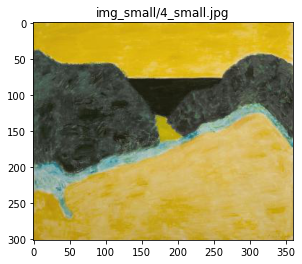

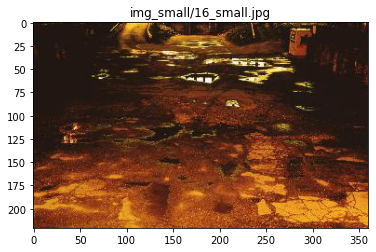

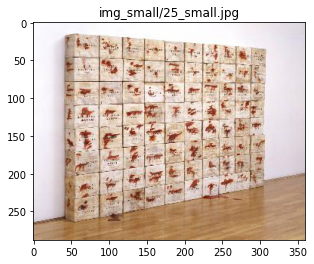

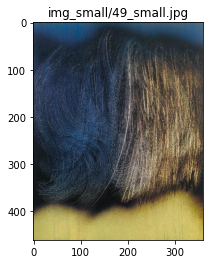

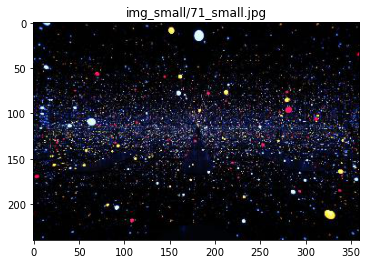

...

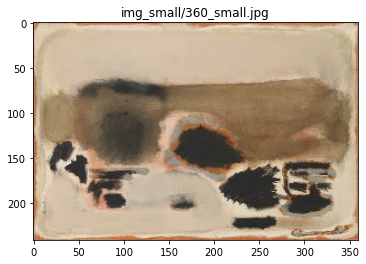

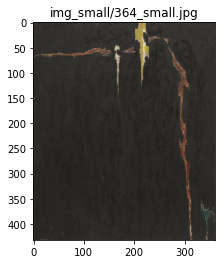

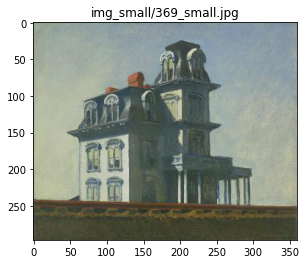

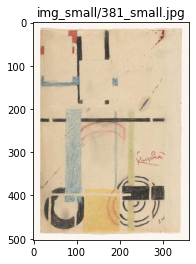

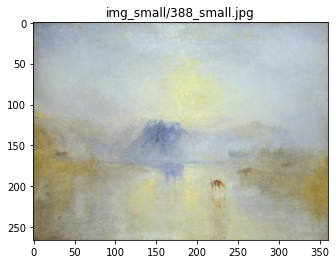

In [190]:
for i in range(0, max(km.labels_)+1):
        for j in range(0, len(km.labels_)):
            if km.labels_[j] == i == 0:
                process('img_small/'+str(j+2) + '_small.jpg')

            

### Cluster_1

/var/folders/qn/rnhppd716mvg1dm26kjg8jyc0000gn/T/ipykernel_25583/3530359695.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


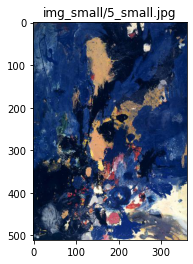

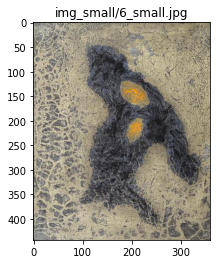

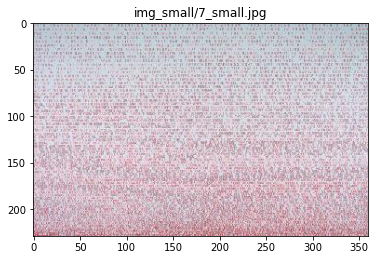

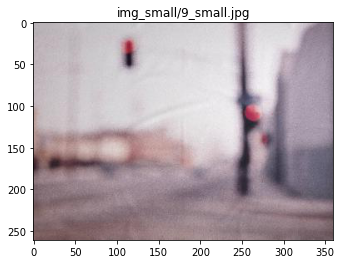

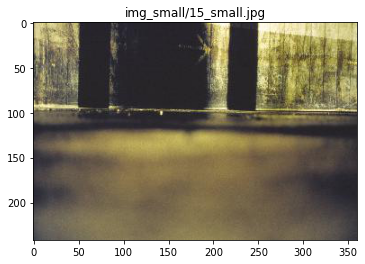

...

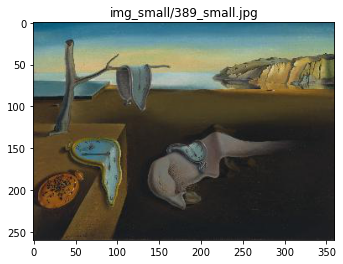

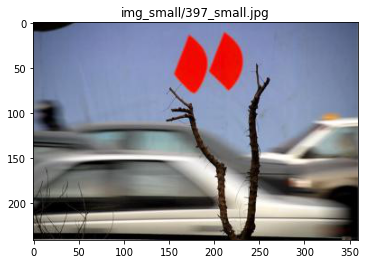

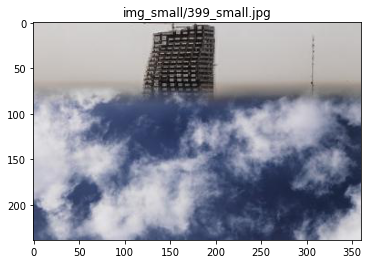

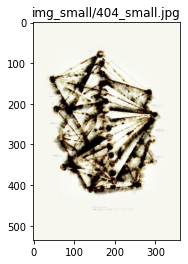

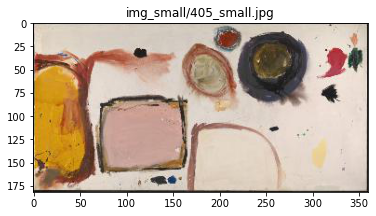

In [191]:
for i in range(0, max(km.labels_)+1):
        for j in range(0, len(km.labels_)):
            if km.labels_[j] == i == 1:
                process('img_small/'+str(j+2) + '_small.jpg')

            

### Cluster_2

/var/folders/qn/rnhppd716mvg1dm26kjg8jyc0000gn/T/ipykernel_25583/3530359695.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


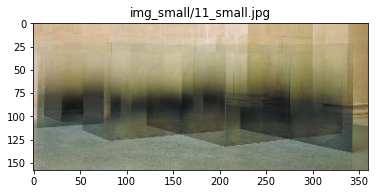

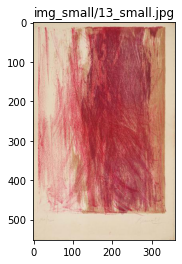

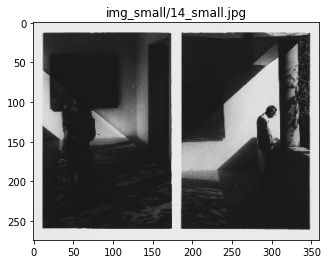

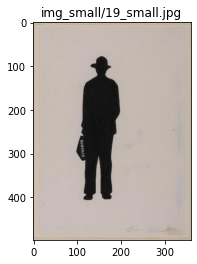

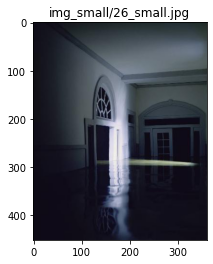

...

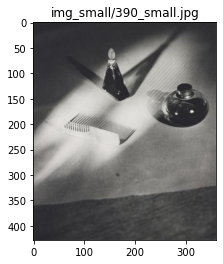

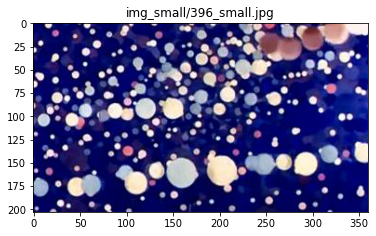

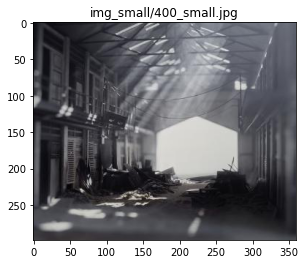

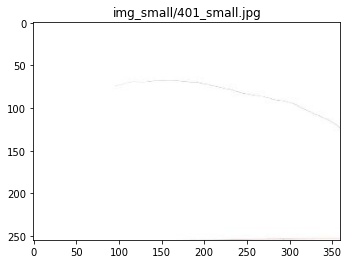

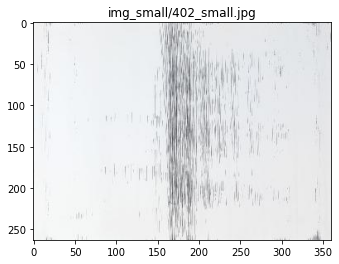

In [192]:
for i in range(0, max(km.labels_)+1):
        for j in range(0, len(km.labels_)):
            if km.labels_[j] == i == 2:
                process('img_small/'+str(j+2) + '_small.jpg')

            

### Cluster_3

/var/folders/qn/rnhppd716mvg1dm26kjg8jyc0000gn/T/ipykernel_25583/3530359695.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


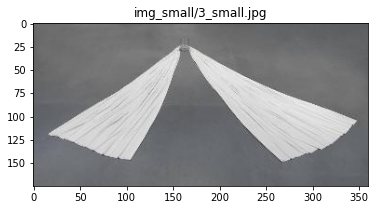

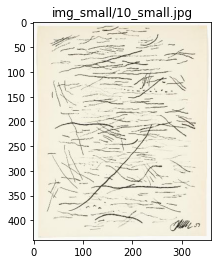

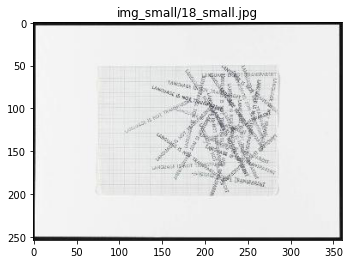

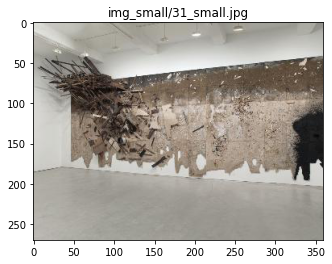

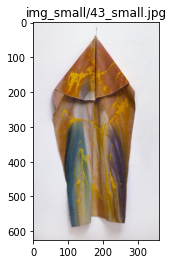

...

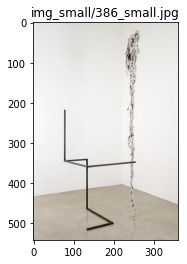

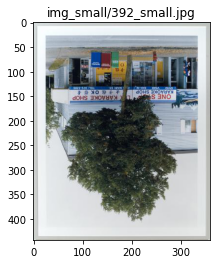

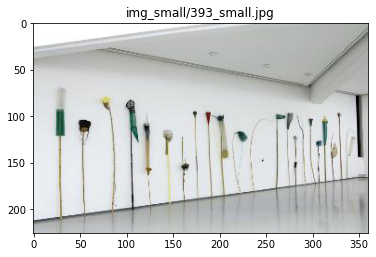

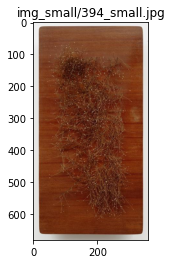

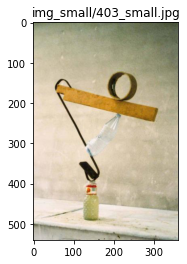

In [193]:
for i in range(0, max(km.labels_)+1):
        for j in range(0, len(km.labels_)):
            if km.labels_[j] == i == 3:
                process('img_small/'+str(j+2) + '_small.jpg')

            

### Cluster_4

/var/folders/qn/rnhppd716mvg1dm26kjg8jyc0000gn/T/ipykernel_25583/3530359695.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


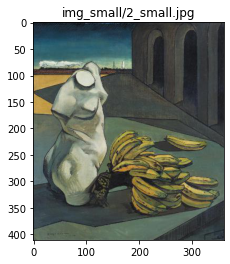

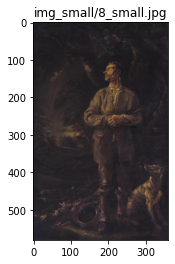

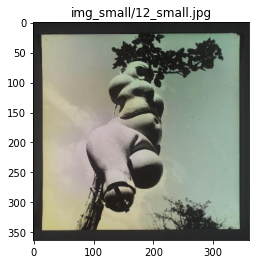

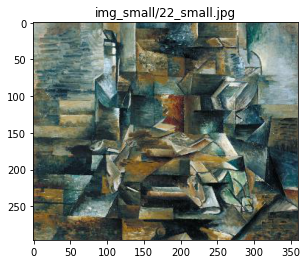

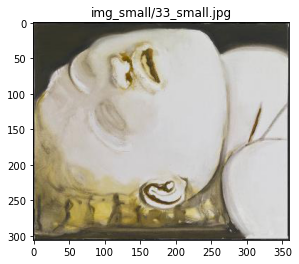

...

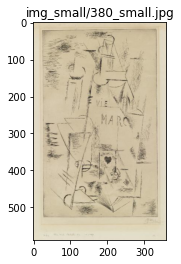

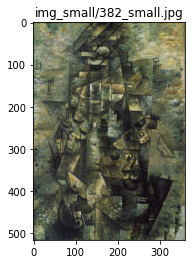

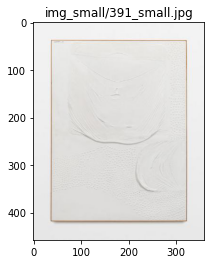

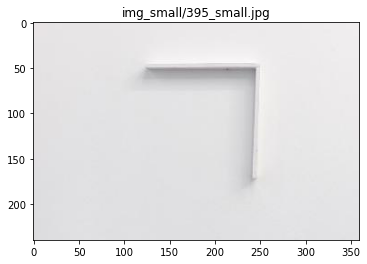

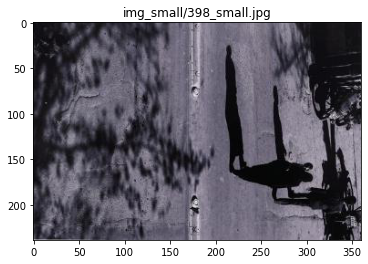

In [194]:
for i in range(0, max(km.labels_)+1):
        for j in range(0, len(km.labels_)):
            if km.labels_[j] == i == 4:
                process('img_small/'+str(j+2) + '_small.jpg')

            

### Cluster_5

In [195]:
for i in range(0, max(km.labels_)+1):
        for j in range(0, len(km.labels_)):
            if km.labels_[j] == i == 5:
                process('img_small/'+str(j+2) + '_small.jpg')

            

### Cluster_6

In [196]:
for i in range(0, max(km.labels_)+1):
        for j in range(0, len(km.labels_)):
            if km.labels_[j] == i == 6:
                process('img_small/'+str(j+2) + '_small.jpg')

            

### Cluster_7

In [197]:
for i in range(0, max(km.labels_)+1):
        for j in range(0, len(km.labels_)):
            if km.labels_[j] == i == 7:
                process('img_small/'+str(j+2) + '_small.jpg')

            